<a href="https://colab.research.google.com/github/parthar409/Thalassemia-Prediction-using-Machine-Learning/blob/main/Thalassemia_Prediction_using_Machine_Learning_Approaches.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Cell 1: Install Libraries and Import Statements
!pip install pandas numpy scikit-learn xgboost shap lime matplotlib seaborn

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, VotingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, roc_auc_score, roc_curve, auc
from google.colab import drive
from sklearn.inspection import permutation_importance

!pip install lime==0.2.0.1
import lime
import lime.lime_tabular

print("Libraries installed and imported successfully!")

Libraries installed and imported successfully!


In [ ]:
# Cell 2: Mount Google Drive
drive.mount('/content/drive')
print("Google Drive mounted successfully!")

Mounted at /content/drive
Google Drive mounted successfully!


In [ ]:
# Cell 3: Load and Preprocess Data
file_path = '/content/drive/MyDrive/Alpha-2_200322.xlsx'  # Replace with your file path
df = pd.read_excel(file_path, sheet_name='all')
df.columns = ['SEA_THAI', 'Value1', 'CS_PS', 'ETC', 'Age', 'Sex', 'Hb', 'Hct',
              'MCV', 'MCH', 'MCHC', 'RDW', 'RBC_count', 'Group']
group_map = {1: 'Normal', 2: 'Alpha-thal-2', 3: 'Alpha-thal-1', 4: 'HbH disease'}
df['Group_Name'] = df['Group'].map(group_map)
df.fillna('Unknown', inplace=True)
categorical_cols = ['SEA_THAI', 'Value1', 'CS_PS', 'ETC', 'Sex', 'Group_Name']
for col in categorical_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
df['Group'] = df['Group'] - 1
important_features = ['RBC_count', 'MCH', 'MCV', 'Hb', 'Hct']
X = df[important_features]
y = df['Group']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

print("Data loaded and preprocessed!")

Data loaded and preprocessed!



--- Logistic Regression ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.76      1.00      0.86        19
Alpha-thal-2       1.00      0.50      0.67        16
Alpha-thal-1       0.79      1.00      0.88        11
 HbH disease       1.00      0.67      0.80         3

    accuracy                           0.82        49
   macro avg       0.89      0.79      0.80        49
weighted avg       0.86      0.82      0.80        49

Accuracy: 0.8163


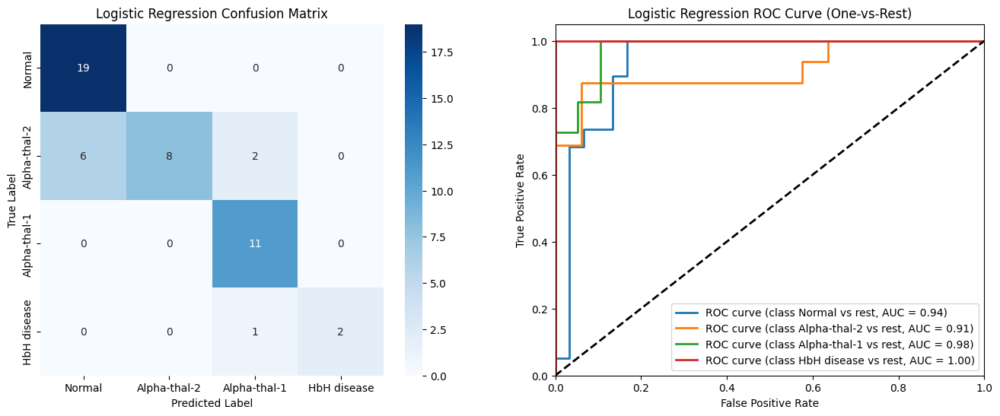

In [ ]:
# Cell 4: Logistic Regression
print("\n--- Logistic Regression ---")

# 1. Create and Train the Model (Updated)
lr_model = LogisticRegression(solver='liblinear', random_state=42)  # Removed multi_class='ovr'
lr_model.fit(X_train, y_train)

# 2. Make Predictions
lr_y_pred = lr_model.predict(X_test)
lr_y_prob = lr_model.predict_proba(X_test)

# 3. Evaluate Performance
print("\nClassification Report:")
print(classification_report(y_test, lr_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, lr_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# 4. Confusion Matrix
cm_lr = confusion_matrix(y_test, lr_y_pred)
sns.heatmap(cm_lr, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('Logistic Regression Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# 5. ROC Curve (One-vs-Rest)
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, lr_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Logistic Regression ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- SVM (Support Vector Machine) ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.80      0.84      0.82        19
Alpha-thal-2       0.77      0.62      0.69        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.82        49
   macro avg       0.85      0.87      0.86        49
weighted avg       0.81      0.82      0.81        49

Accuracy: 0.8163


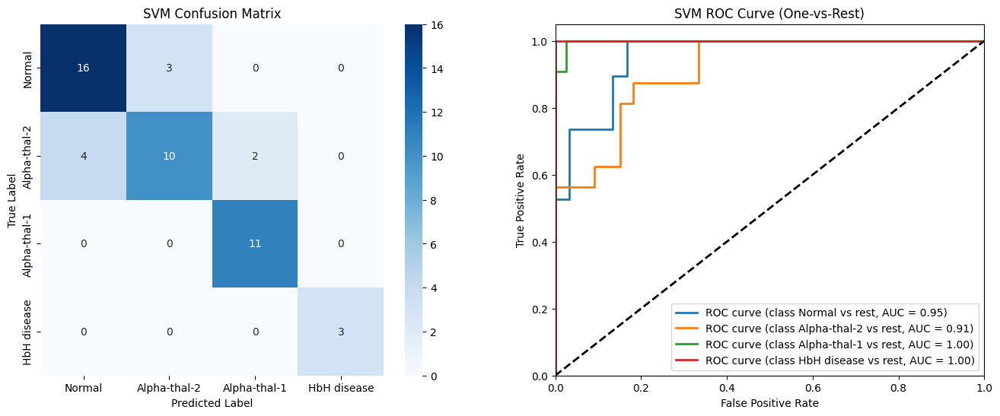

In [ ]:
# Cell 5: SVM (Support Vector Machine)
print("\n--- SVM (Support Vector Machine) ---")
svm_model = SVC(probability=True, random_state=42)
svm_model.fit(X_train, y_train)
svm_y_pred = svm_model.predict(X_test)
svm_y_prob = svm_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, svm_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, svm_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_svm = confusion_matrix(y_test, svm_y_pred)
sns.heatmap(cm_svm, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('SVM Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, svm_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('SVM ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Decision Tree ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.71      0.79      0.75        19
Alpha-thal-2       0.62      0.62      0.62        16
Alpha-thal-1       1.00      0.82      0.90        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.76        49
   macro avg       0.83      0.81      0.82        49
weighted avg       0.77      0.76      0.76        49

Accuracy: 0.7551


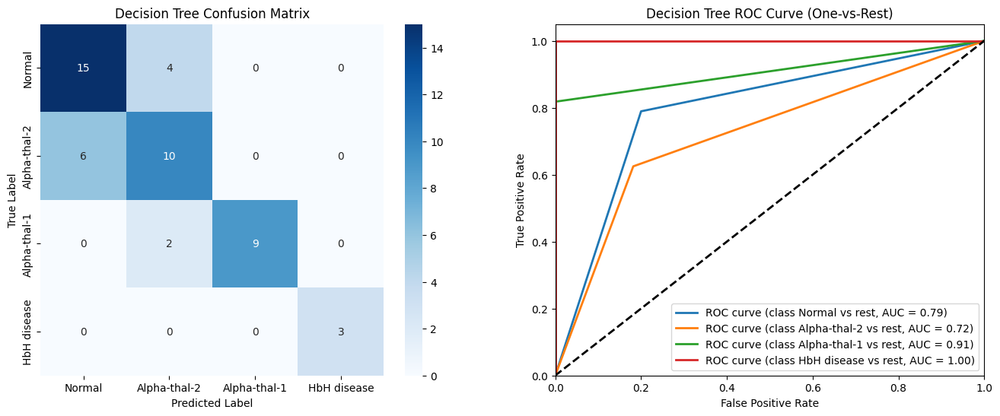

In [ ]:
# Cell 6: Decision Tree
print("\n--- Decision Tree ---")
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)
dt_y_pred = dt_model.predict(X_test)
dt_y_prob = dt_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, dt_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, dt_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_dt = confusion_matrix(y_test, dt_y_pred)
sns.heatmap(cm_dt, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('Decision Tree Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, dt_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Decision Tree ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Random Forest ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.83      0.79      0.81        19
Alpha-thal-2       0.73      0.69      0.71        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.82        49
   macro avg       0.85      0.87      0.86        49
weighted avg       0.81      0.82      0.81        49

Accuracy: 0.8163


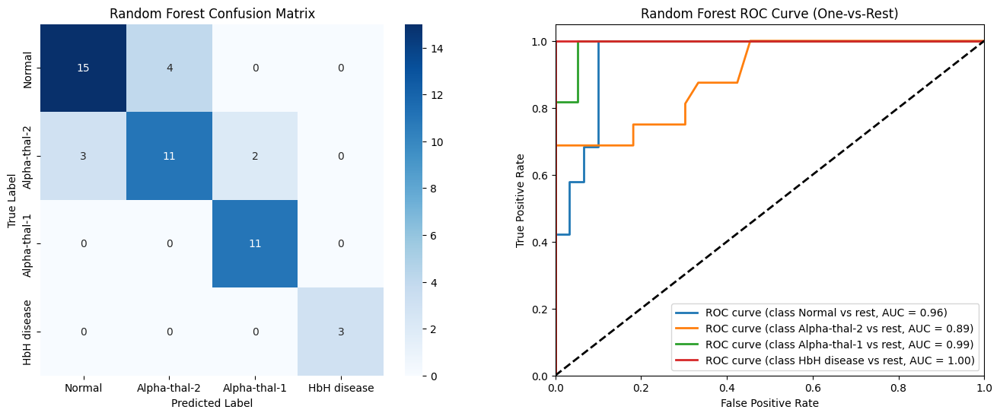

In [ ]:
# Cell 7: Random Forest
print("\n--- Random Forest ---")
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)
rf_y_pred = rf_model.predict(X_test)
rf_y_prob = rf_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, rf_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, rf_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_rf = confusion_matrix(y_test, rf_y_pred)
sns.heatmap(cm_rf, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('Random Forest Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, rf_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Random Forest ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- AdaBoost ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.67      0.53      0.59        19
Alpha-thal-2       0.50      0.56      0.53        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.67        49
   macro avg       0.75      0.77      0.76        49
weighted avg       0.67      0.67      0.67        49

Accuracy: 0.6735


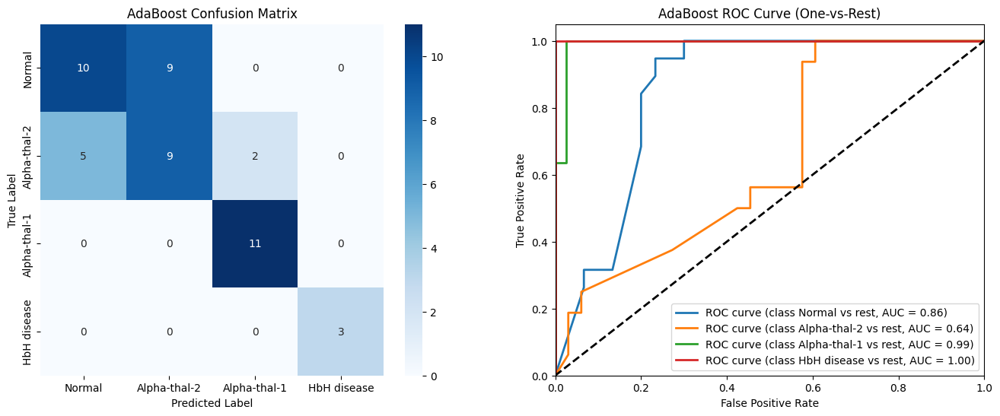

In [ ]:
# Cell 8: AdaBoost
print("\n--- AdaBoost ---")
ab_model = AdaBoostClassifier(random_state=42)
ab_model.fit(X_train, y_train)
ab_y_pred = ab_model.predict(X_test)
ab_y_prob = ab_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, ab_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, ab_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_ab = confusion_matrix(y_test, ab_y_pred)
sns.heatmap(cm_ab, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('AdaBoost Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, ab_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('AdaBoost ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Naive Bayes ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.76      0.84      0.80        19
Alpha-thal-2       0.75      0.56      0.64        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.80        49
   macro avg       0.84      0.85      0.84        49
weighted avg       0.79      0.80      0.79        49

Accuracy: 0.7959


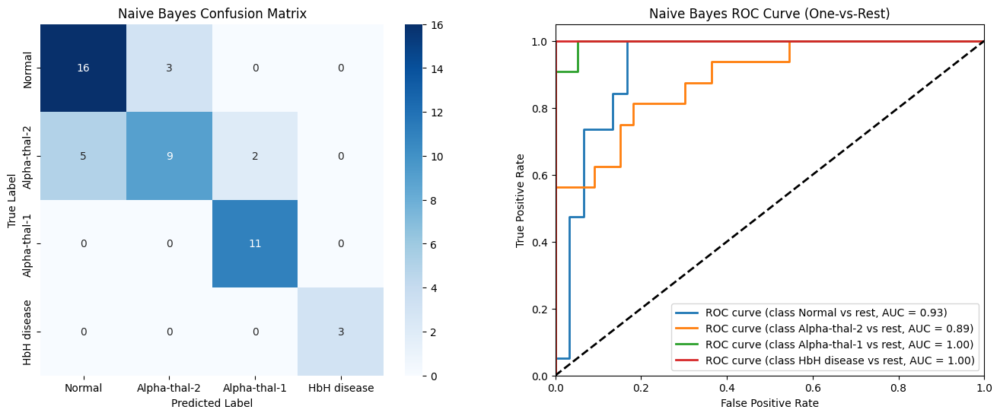

In [ ]:
# Cell 9: Naive Bayes
print("\n--- Naive Bayes ---")
nb_model = GaussianNB()
nb_model.fit(X_train, y_train)
nb_y_pred = nb_model.predict(X_test)
nb_y_prob = nb_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, nb_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, nb_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_nb = confusion_matrix(y_test, nb_y_pred)
sns.heatmap(cm_nb, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('Naive Bayes Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, nb_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Naive Bayes ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- KNN (K-Nearest Neighbors) ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.81      0.89      0.85        19
Alpha-thal-2       0.85      0.69      0.76        16
Alpha-thal-1       0.92      1.00      0.96        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.86        49
   macro avg       0.89      0.90      0.89        49
weighted avg       0.86      0.86      0.85        49

Accuracy: 0.8571


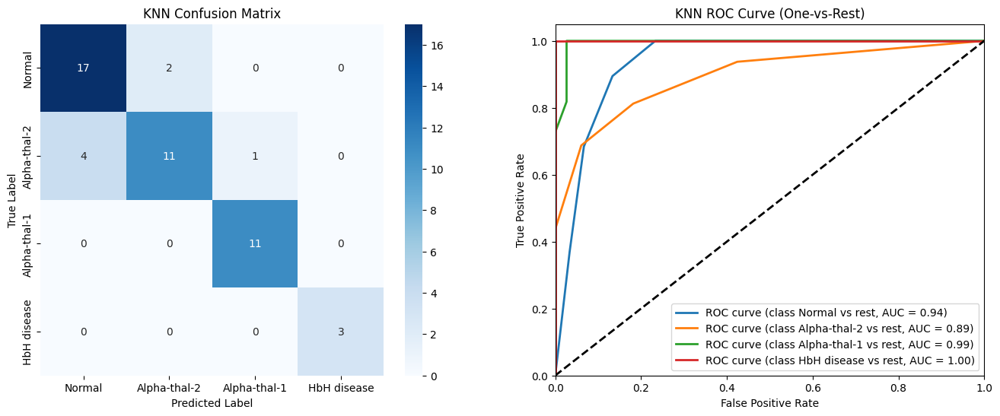

In [ ]:
# Cell 10: KNN (K-Nearest Neighbors)
print("\n--- KNN (K-Nearest Neighbors) ---")
knn_model = KNeighborsClassifier()
knn_model.fit(X_train, y_train)
knn_y_pred = knn_model.predict(X_test)
knn_y_prob = knn_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, knn_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, knn_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_knn = confusion_matrix(y_test, knn_y_pred)
sns.heatmap(cm_knn, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('KNN Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, knn_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('KNN ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- MLP (Multi-Layer Perceptron) ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.74      0.74      0.74        19
Alpha-thal-2       0.62      0.50      0.55        16
Alpha-thal-1       0.73      1.00      0.85        11
 HbH disease       0.50      0.33      0.40         3

    accuracy                           0.69        49
   macro avg       0.65      0.64      0.63        49
weighted avg       0.68      0.69      0.68        49

Accuracy: 0.6939


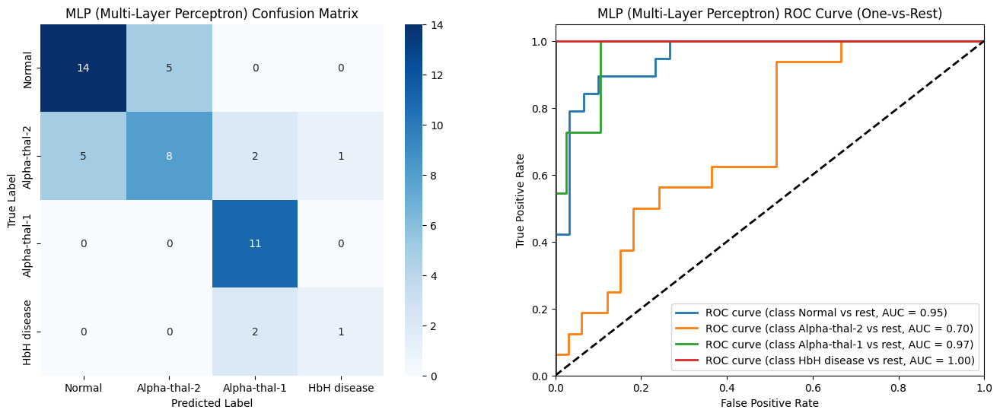

In [ ]:
# Cell 11: MLP (Multi-Layer Perceptron)
print("\n--- MLP (Multi-Layer Perceptron) ---")
mlp_model = MLPClassifier(random_state=42, max_iter=1000, # Increased max_iter
                              early_stopping=True, validation_fraction=0.1)  # Added early stopping
mlp_model.fit(X_train, y_train)
mlp_y_pred = mlp_model.predict(X_test)
mlp_y_prob = mlp_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, mlp_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, mlp_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_mlp = confusion_matrix(y_test, mlp_y_pred)
sns.heatmap(cm_mlp, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('MLP (Multi-Layer Perceptron) Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, mlp_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('MLP (Multi-Layer Perceptron) ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- XGBoost ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.81      0.68      0.74        19
Alpha-thal-2       0.65      0.69      0.67        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.78        49
   macro avg       0.83      0.84      0.83        49
weighted avg       0.78      0.78      0.77        49

Accuracy: 0.7755


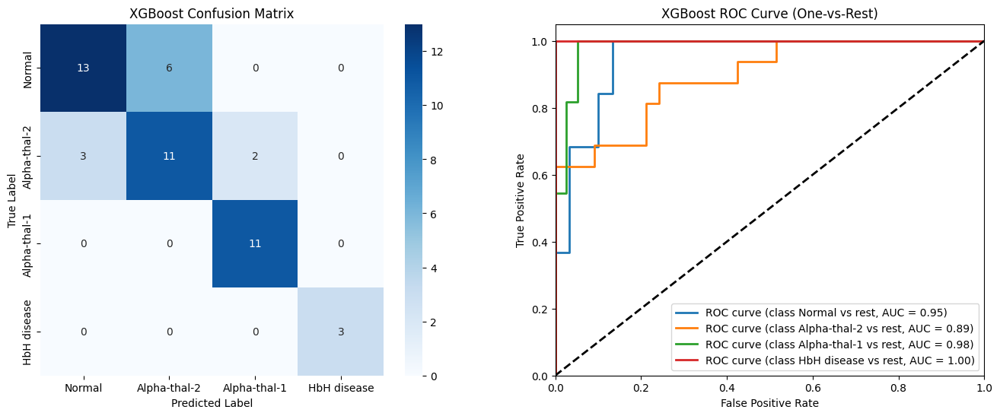

In [ ]:
# Cell 12: XGBoost
print("\n--- XGBoost ---")
xgb_model = XGBClassifier(random_state=42, eval_metric='mlogloss')  # Removed use_label_encoder
xgb_model.fit(X_train, y_train)
xgb_y_pred = xgb_model.predict(X_test)
xgb_y_prob = xgb_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, xgb_y_pred, target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, xgb_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_xgb = confusion_matrix(y_test, xgb_y_pred)
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()), yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('XGBoost Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, xgb_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2, label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('XGBoost ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

plt.show() # Display the figure with both subplots


--- Voting Classifier ---

Classification Report:
              precision    recall  f1-score   support

      Normal       0.84      0.84      0.84        19
Alpha-thal-2       0.79      0.69      0.73        16
Alpha-thal-1       0.85      1.00      0.92        11
 HbH disease       1.00      1.00      1.00         3

    accuracy                           0.84        49
   macro avg       0.87      0.88      0.87        49
weighted avg       0.83      0.84      0.83        49

Accuracy: 0.8367


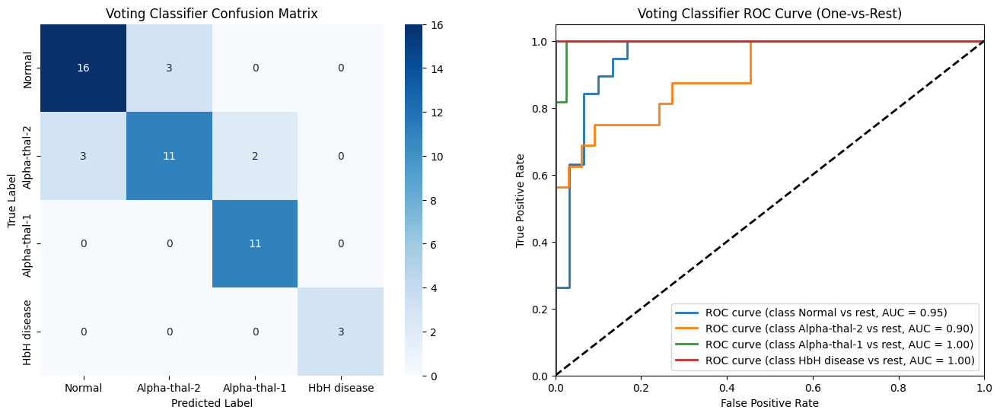

In [ ]:
# Cell 13: VotingClassifier
print("\n--- Voting Classifier ---")
from xgboost import XGBClassifier  # Import XGBClassifier
vc_model = VotingClassifier(
    estimators=[
        ('lr', LogisticRegression(solver='liblinear', random_state=42)),
        ('svm', SVC(probability=True, random_state=42)),
        ('dt', DecisionTreeClassifier(random_state=42)),
        ('rf', RandomForestClassifier(random_state=42)),
        ('ab', AdaBoostClassifier(random_state=42)),
        ('gnb', GaussianNB()),
        ('knn', KNeighborsClassifier()),
        ('mlp', MLPClassifier(random_state=42, max_iter=1000,
                              early_stopping=True, validation_fraction=0.1)),
        ('xgb', XGBClassifier(random_state=42, eval_metric='mlogloss'))
    ],
    voting='soft'
)
vc_model.fit(X_train, y_train)
vc_y_pred = vc_model.predict(X_test)
vc_y_prob = vc_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, vc_y_pred,
                            target_names=list(group_map.values())))
print(f"Accuracy: {accuracy_score(y_test, vc_y_pred):.4f}")

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot Confusion Matrix on the first subplot
cm_vc = confusion_matrix(y_test, vc_y_pred)
sns.heatmap(cm_vc, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(group_map.values()),
            yticklabels=list(group_map.values()), ax=axes[0])
axes[0].set_title('Voting Classifier Confusion Matrix')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')


# Plot ROC Curve on the second subplot
n_classes = len(group_map)
for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_test == i, vc_y_prob[:, i])
    roc_auc = auc(fpr, tpr)
    axes[1].plot(fpr, tpr, lw=2,
                 label=f'ROC curve (class {list(group_map.values())[i]} vs rest, AUC = {roc_auc:.2f})')
axes[1].plot([0, 1], [0, 1], 'k--', lw=2)
axes[1].set_xlim([0.0, 1.0])
axes[1].set_ylim([0.0, 1.05])
axes[1].set_xlabel('False Positive Rate')
axes[1].set_ylabel('True Positive Rate')
axes[1].set_title('Voting Classifier ROC Curve (One-vs-Rest)')
axes[1].legend(loc="lower right")

# Display the figure with both subplots
plt.show()


--- Logistic Regression Feature Importance and LIME ---

Feature Importance (Absolute Coefficients):
     Feature  Importance
1        MCH    1.309567
2        MCV    0.867160
3         Hb    0.606305
0  RBC_count    0.468638
4        Hct    0.242316


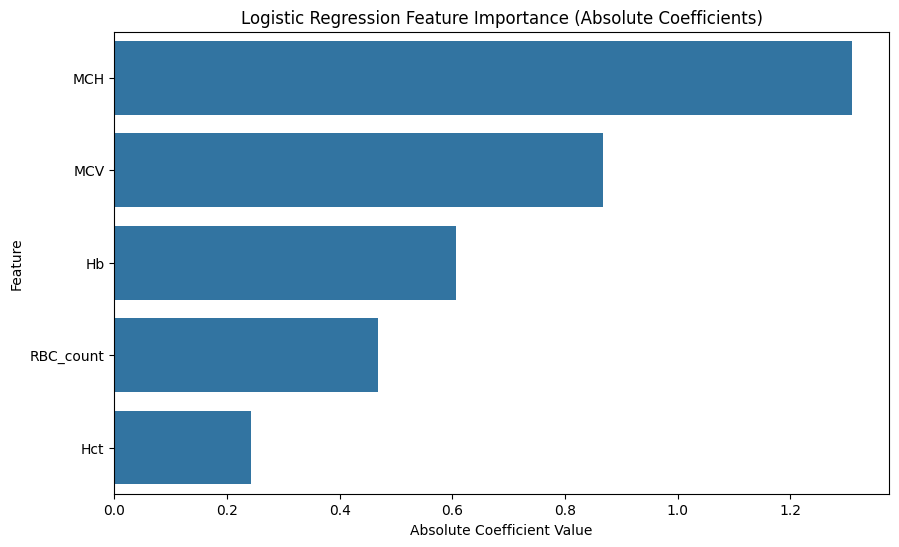


LIME Explanation (Instance 0):


In [ ]:
# Cell 14: Logistic Regression Feature Importance and LIME

print("\n--- Logistic Regression Feature Importance and LIME ---")
if hasattr(lr_model, 'coef_'):
    importance_lr = np.abs(lr_model.coef_[0]) # For binary or OvR
    feature_importance_lr = pd.DataFrame({'Feature': important_features, 'Importance': importance_lr})
    feature_importance_lr = feature_importance_lr.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance (Absolute Coefficients):")
    print(feature_importance_lr)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_lr)
    plt.title('Logistic Regression Feature Importance (Absolute Coefficients)')
    plt.xlabel('Absolute Coefficient Value')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Logistic Regression model does not have 'coef_' attribute for feature importance.")

try:
    explainer_lime_lr = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_lr = explainer_lime_lr.explain_instance(X_test[0], lr_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_lr.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Logistic Regression: {e}")


--- SVM Feature Importance and LIME ---

Feature Importance (Permutation Importance):
     Feature  Importance
1        MCH    0.255102
3         Hb    0.114286
2        MCV    0.104082
0  RBC_count    0.065306
4        Hct   -0.026531


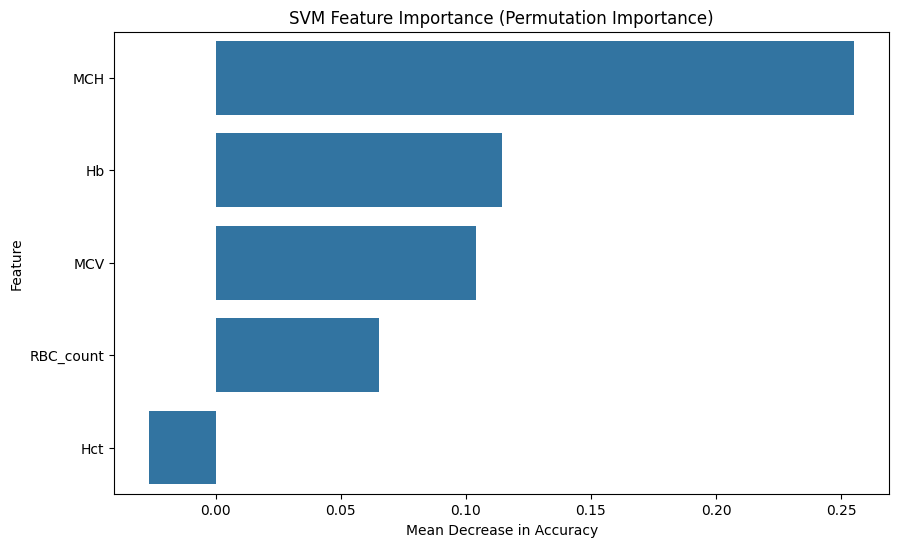


LIME Explanation (Instance 0):


In [ ]:
# Cell 15: SVM Feature Importance and LIME
print("\n--- SVM Feature Importance and LIME ---")
from sklearn.inspection import permutation_importance

result_svm = permutation_importance(svm_model, X_test, y_test, n_repeats=10, random_state=42)
importance_svm = result_svm.importances_mean
feature_importance_svm = pd.DataFrame({'Feature': important_features, 'Importance': importance_svm})
feature_importance_svm = feature_importance_svm.sort_values(by='Importance', ascending=False)
print("\nFeature Importance (Permutation Importance):")
print(feature_importance_svm)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_svm)
plt.title('SVM Feature Importance (Permutation Importance)')
plt.xlabel('Mean Decrease in Accuracy')
plt.ylabel('Feature')
plt.show()

try:
    explainer_lime_svm = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_svm = explainer_lime_svm.explain_instance(X_test[0], svm_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_svm.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for SVM: {e}")


--- Decision Tree Feature Importance and LIME ---

Feature Importance:
     Feature  Importance
1        MCH    0.733828
2        MCV    0.128071
4        Hct    0.072196
3         Hb    0.035027
0  RBC_count    0.030878


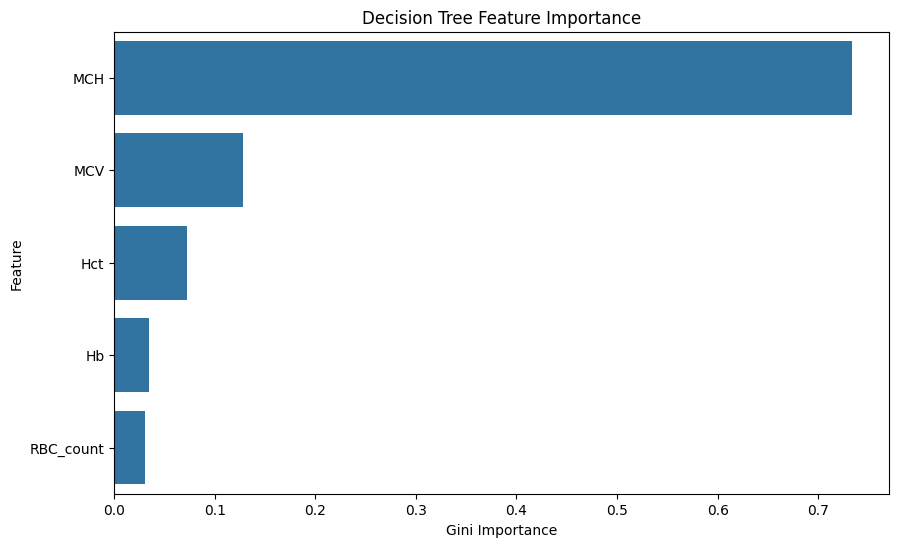


LIME Explanation (Instance 0):


In [ ]:
# Cell 16: Decision Tree Feature Importance and LIME
print("\n--- Decision Tree Feature Importance and LIME ---")
if hasattr(dt_model, 'feature_importances_'):
    importance_dt = dt_model.feature_importances_
    feature_importance_dt = pd.DataFrame({'Feature': important_features, 'Importance': importance_dt})
    feature_importance_dt = feature_importance_dt.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_dt)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_dt)
    plt.title('Decision Tree Feature Importance')
    plt.xlabel('Gini Importance')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Decision Tree model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_dt = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_dt = explainer_lime_dt.explain_instance(X_test[0], dt_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_dt.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Decision Tree: {e}")


--- Random Forest Feature Importance and LIME ---

Feature Importance:
     Feature  Importance
1        MCH    0.400234
2        MCV    0.276247
0  RBC_count    0.121762
3         Hb    0.109406
4        Hct    0.092351


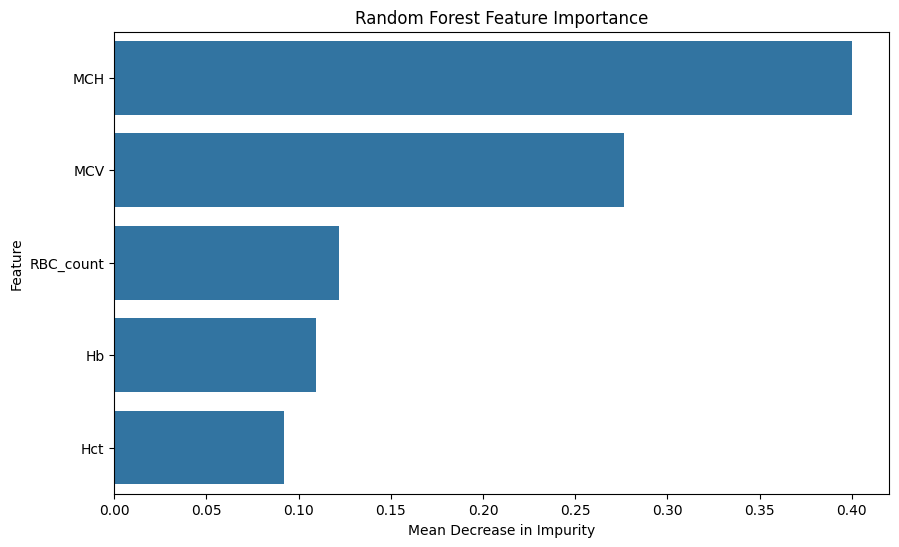


LIME Explanation (Instance 0):


In [ ]:
# Cell 17: Random Forest Feature Importance and LIME
print("\n--- Random Forest Feature Importance and LIME ---")
if hasattr(rf_model, 'feature_importances_'):
    importance_rf = rf_model.feature_importances_
    feature_importance_rf = pd.DataFrame({'Feature': important_features, 'Importance': importance_rf})
    feature_importance_rf = feature_importance_rf.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_rf)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_rf)
    plt.title('Random Forest Feature Importance')
    plt.xlabel('Mean Decrease in Impurity')
    plt.ylabel('Feature')
    plt.show()
else:
    print("Random Forest model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_rf = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_rf = explainer_lime_rf.explain_instance(X_test[0], rf_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_rf.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Random Forest: {e}")


--- AdaBoost Feature Importance and LIME ---

Feature Importance:
     Feature  Importance
1        MCH    0.741982
0  RBC_count    0.105271
4        Hct    0.067502
2        MCV    0.067027
3         Hb    0.018219


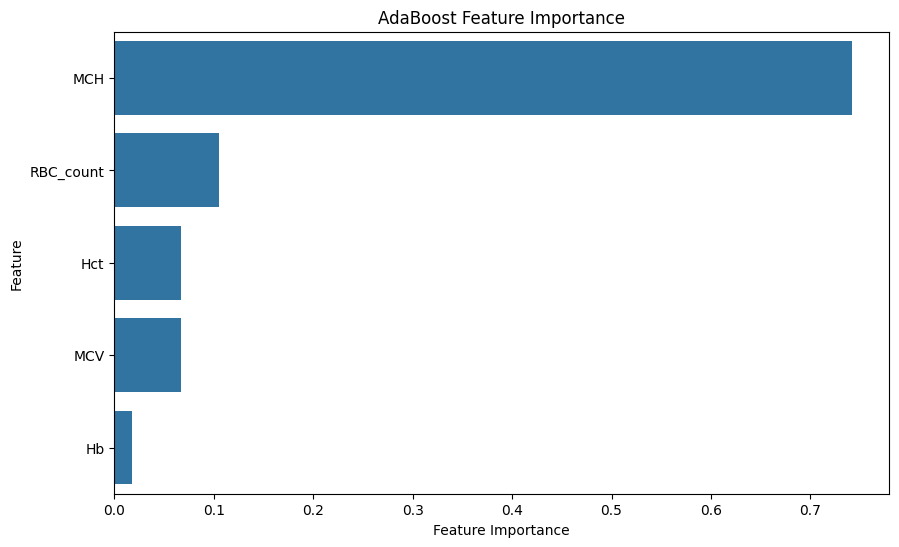


LIME Explanation (Instance 0):


In [ ]:
# Cell 18: AdaBoost Feature Importance and LIME
print("\n--- AdaBoost Feature Importance and LIME ---")
if hasattr(ab_model, 'feature_importances_'):
    importance_ab = ab_model.feature_importances_
    feature_importance_ab = pd.DataFrame({'Feature': important_features, 'Importance': importance_ab})
    feature_importance_ab = feature_importance_ab.sort_values(by='Importance', ascending=False)
    print("\nFeature Importance:")
    print(feature_importance_ab)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_ab)
    plt.title('AdaBoost Feature Importance')
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature')
    plt.show()
else:
    print("AdaBoost model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_ab = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_ab = explainer_lime_ab.explain_instance(X_test[0], ab_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_ab.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for AdaBoost: {e}")

In [ ]:
# Cell 19: Naive Bayes Feature Importance and LIME
print("\n--- Naive Bayes Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for Naive Bayes.")



result = permutation_importance(nb_model, X_test, y_test, n_repeats=10, random_state=42)
importance = result.importances_mean
feature_importance = pd.DataFrame({'Feature': important_features, 'Importance': importance})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print("\nPermutation Feature Importance:")
print(feature_importance)

# 2. LIME Explanation
try:
    explainer_lime_nb = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_nb = explainer_lime_nb.explain_instance(X_test[0], nb_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_nb.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for Naive Bayes: {e}")


--- Naive Bayes Feature Importance and LIME ---

Feature importance is not directly interpretable for Naive Bayes.

Permutation Feature Importance:
     Feature  Importance
1        MCH    0.232653
2        MCV    0.071429
3         Hb    0.000000
0  RBC_count   -0.016327
4        Hct   -0.024490

LIME Explanation (Instance 0):


In [ ]:
# Cell 20: KNN Feature Importance and LIME
print("\n--- KNN Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for KNN.")
try:
    explainer_lime_knn = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_knn = explainer_lime_knn.explain_instance(X_test[0], knn_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_knn.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for KNN: {e}")


--- KNN Feature Importance and LIME ---

Feature importance is not directly interpretable for KNN.

LIME Explanation (Instance 0):



--- MLP Feature Importance and LIME ---

Feature Importance (Permutation Importance):
     Feature  Importance
0  RBC_count    0.148980
1        MCH    0.171429
2        MCV    0.036735
3         Hb    0.102041
4        Hct   -0.034694


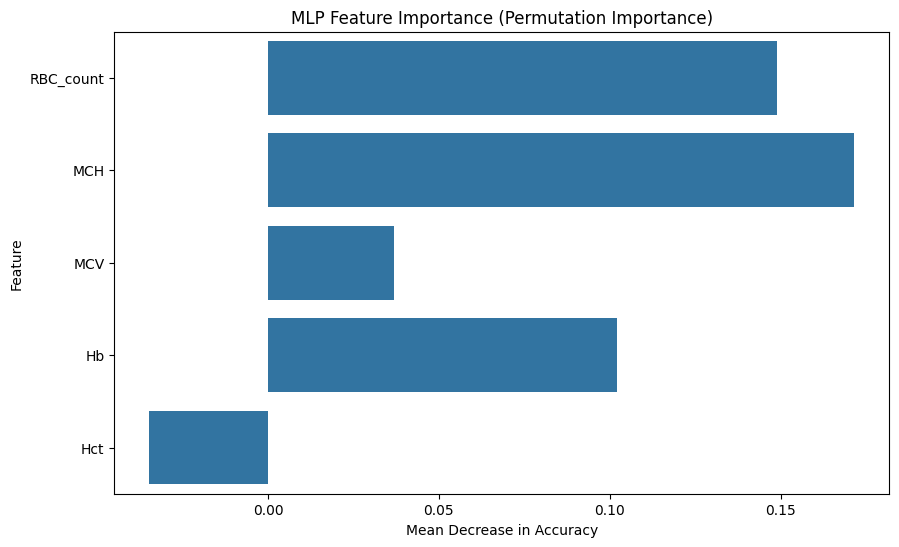


LIME Explanation (Instance 0):


In [ ]:
# Cell 21: MLP Feature Importance and LIME
print("\n--- MLP Feature Importance and LIME ---")
result_mlp = permutation_importance(mlp_model, X_test, y_test, n_repeats=10, random_state=42)
importance_mlp = result_mlp.importances_mean
feature_importance_mlp = pd.DataFrame({'Feature': important_features, 'Importance': importance_mlp})
print("\nFeature Importance (Permutation Importance):")
print(feature_importance_mlp)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_mlp)
plt.title('MLP Feature Importance (Permutation Importance)')
plt.xlabel('Mean Decrease in Accuracy')
plt.ylabel('Feature')
plt.show()

try:
    explainer_lime_mlp = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_mlp = explainer_lime_mlp.explain_instance(X_test[0], mlp_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_mlp.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for MLP: {e}")


--- XGBoost Feature Importance and LIME ---

Feature Importance:
     Feature  Importance
0  RBC_count    0.066552
1        MCH    0.664904
2        MCV    0.095254
3         Hb    0.113560
4        Hct    0.059731


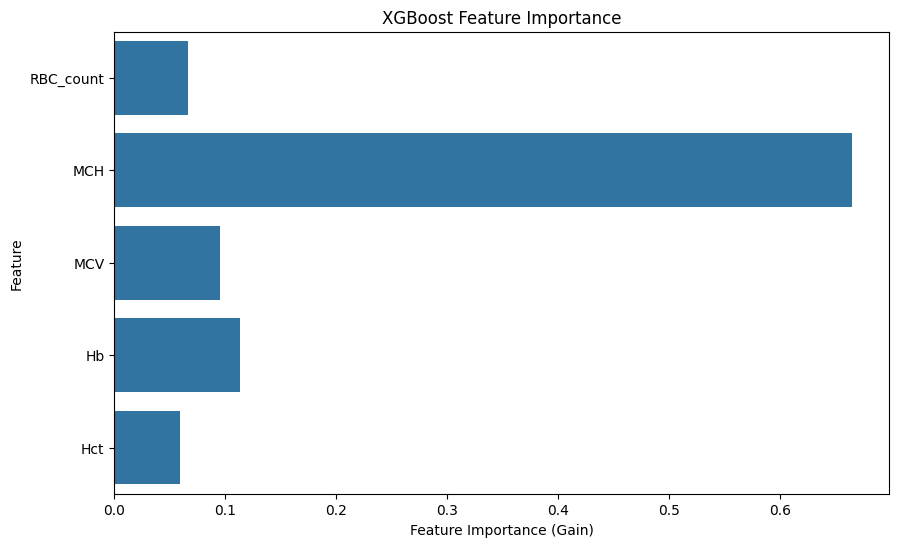


LIME Explanation (Instance 0):


In [ ]:
# Cell 22: XGBoost Feature Importance and LIME
print("\n--- XGBoost Feature Importance and LIME ---")
if hasattr(xgb_model, 'feature_importances_'):
    importance_xgb = xgb_model.feature_importances_
    feature_importance_xgb = pd.DataFrame({'Feature': important_features, 'Importance': importance_xgb})
    print("\nFeature Importance:")
    print(feature_importance_xgb)

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_xgb)
    plt.title('XGBoost Feature Importance')
    plt.xlabel('Feature Importance (Gain)')
    plt.ylabel('Feature')
    plt.show()
else:
    print("XGBoost model does not have 'feature_importances_' attribute.")

try:
    explainer_lime_xgb = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_xgb = explainer_lime_xgb.explain_instance(X_test[0], xgb_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_xgb.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for XGBoost: {e}")

In [ ]:
# Cell 23: VotingClassifier Feature Importance and LIME
print("\n--- Voting Classifier Feature Importance and LIME ---")
print("\nFeature importance is not directly interpretable for a VotingClassifier.")
try:
    explainer_lime_vc = lime.lime_tabular.LimeTabularExplainer(
        X_train, feature_names=important_features,
        class_names=list(group_map.values()), mode='classification')
    explanation_vc = explainer_lime_vc.explain_instance(X_test[0], vc_model.predict_proba, num_features=len(important_features))
    print("\nLIME Explanation (Instance 0):")
    explanation_vc.show_in_notebook(show_table=True, show_all=False)
except Exception as e:
    print(f"Error generating LIME report for VotingClassifier: {e}")


--- Voting Classifier Feature Importance and LIME ---

Feature importance is not directly interpretable for a VotingClassifier.

LIME Explanation (Instance 0):



--- Algorithm Performance Summary (Accuracy and Error) ---
                    Accuracy Error Rate
Logistic Regression   0.8163     0.1837
SVM                   0.8163     0.1837
Decision Tree         0.7551     0.2449
Random Forest         0.8163     0.1837
AdaBoost              0.6735     0.3265
Naive Bayes           0.7959     0.2041
KNN                   0.8571     0.1429
MLP                   0.6939     0.3061
XGBoost               0.7755     0.2245
Voting Classifier     0.8367     0.1633


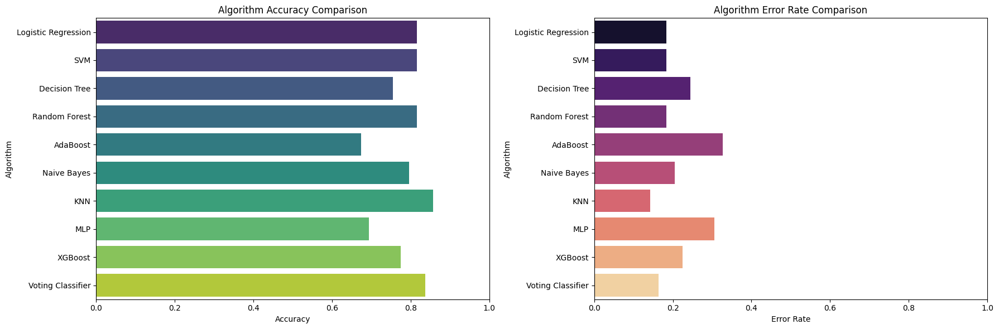

In [ ]:
# Cell 24: Algorithm Performance Summary (Accuracy and Error)
print("\n--- Algorithm Performance Summary (Accuracy and Error) ---")

# 1. Create a dictionary to store the trained models
trained_models = {
    'Logistic Regression': lr_model,
    'SVM': svm_model,
    'Decision Tree': dt_model,
    'Random Forest': rf_model,
    'AdaBoost': ab_model,
    'Naive Bayes': nb_model,
    'KNN': knn_model,
    'MLP': mlp_model,
    'XGBoost': xgb_model,
    'Voting Classifier': vc_model  # Add the VotingClassifier
}

# 2. Calculate and store performance metrics
performance_summary = {}
for name, model in trained_models.items():
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    error_rate = 1 - accuracy
    performance_summary[name] = {'Accuracy': f'{accuracy:.4f}', 'Error Rate': f'{error_rate:.4f}'}

# 3. Create a DataFrame for easy viewing
performance_df = pd.DataFrame.from_dict(performance_summary, orient='index')
print(performance_df)

# 4. Create lists for accuracy and error rate values
accuracies = [float(v['Accuracy']) for v in performance_summary.values()]
error_rates = [float(v['Error Rate']) for v in performance_summary.values()]
model_names = list(performance_summary.keys())  # Get model names

# 5. Visualize Accuracy and Error Rate in Subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 6))  # Create a figure with 2 subplots

# Accuracy Subplot
sns.barplot(x=accuracies, y=model_names, hue=model_names, palette='viridis', dodge=False, legend=False, ax=axes[0])  # Updated
axes[0].set_title('Algorithm Accuracy Comparison')
axes[0].set_xlabel('Accuracy')
axes[0].set_ylabel('Algorithm')
axes[0].set_xlim(0, 1)

# Error Rate Subplot
sns.barplot(x=error_rates, y=model_names, hue=model_names, palette='magma', dodge=False, legend=False, ax=axes[1])  # Updated
axes[1].set_title('Algorithm Error Rate Comparison')
axes[1].set_xlabel('Error Rate')
axes[1].set_ylabel('Algorithm')
axes[1].set_xlim(0, 1)

# Display the figure with both subplots
plt.tight_layout()  # Adjust layout for better spacing
plt.show()